In [1]:
import matplotlib.pyplot as plt
import numpy as np
import csv
import pandas as pd

# Code

In [2]:
w = [0.3, 20.1] # parametres du modele generatif

age_min = 18
age_max = 90
noise = 0.6

def data_gen(modele_gen, nb_tar = 80, nb_mov = 80):
    """generate synthetic moving and target age-related data.

    Keyword arguments:
    modele_gen -- the underlying model behind the data
    nb_tar -- number of subjects in the target site
    nb_mov -- number of subjects in the moving site
    
    Return variables:
    age_tar, y_tar : age and metric values for the subjects in the target site
    age_mov, y_mov : age and metric values for the subjects in the moving site
    """
    
    age_tar = np.random.rand(nb_tar)*(age_max - age_min) + age_min
    age_tar.sort()
    
    age_mov = np.random.rand(nb_mov)*(age_max - age_min) + age_min
    age_mov.sort()
    
    if modele_gen == 'lineaire':
        y_tar = w[0]*30 - age_tar * w[1]/200 + \
            np.random.randn(nb_tar) * noise
        y_mov = w[0]*30 - age_mov * w[1]/100 + \
            np.random.randn(nb_mov) * noise*0.6 - 2
    elif modele_gen == 'horizontal':
        y_tar = w[0]*17 + \
            np.random.randn(nb_tar) * noise
        y_mov = w[0]*14 + \
            np.random.randn(nb_mov) * noise
    else:
        y_tar = np.maximum(0,((age_tar - 50)/90) * w[1]*1.3 ) + \
            np.random.randn(nb_tar) * noise + 3.5
        y_mov = np.maximum(0,((age_mov - 50)/90) * w[1]*0.6 ) + \
            np.random.randn(nb_mov) * noise/2.5 + 2

    return age_tar, y_tar, age_mov, y_mov

In [3]:
def plot_distribution(age_tar, y_tar, 
                      age_mov = None, y_mov = None, 
                      w_tar = None, w_mov = None,
                      age_other = None, y_other = None, 
                      show = True, uncertainty = -1):
    """Plot the target (and the moving and other if not None) data

    Keyword arguments:
    age_tar, y_tar : age and metric values for the subjects in the target site
    age_mov, y_mov : age and metric values for the subjects in the moving site
    age_other, y_other : age and metric values for the subjects from some other site
    w_tar, w_mov : regression parameters for the target and moving site
    show : force the display of the plot
    uncertainty : plot a STD bar on top of the scattered points.
    
    Return variables:
    None
    """

    # Plot the target regression curve
    if w_tar is not None:
        age_min = np.min(age_tar)
        age_max = np.max(age_tar)
        
        x_mod = np.arange(age_min, age_max, 1)
        phi_x_mod = polynomial_basis_function(x_mod, np.size(w_tar)-1)
        t_mod = np.dot(w_tar, phi_x_mod.T)
        
        t_mod = np.dot(phi_x_mod, w_tar) 
        plt.plot(x_mod, t_mod, color='r')

    # Plot the moving regression curve
    if w_mov is not None:
        age_min = np.min(age_mov)
        age_max = np.max(age_mov)
        
        phi_x_mod = polynomial_basis_function(x_mod, np.size(w_mov)-1)
        t_mod = np.dot(w_mov, phi_x_mod.T)
        
        t_mod = np.dot(phi_x_mod, w_mov) 
        plt.plot(x_mod, t_mod, color='b', linestyle='--')

    if age_other is not None and y_other is not None:
        plt.scatter(age_other, y_other, color='b', s=1)
    plt.scatter(age_tar, y_tar, color='y', s=20)
    plt.scatter(age_mov, y_mov, color='k', marker='x', linewidths=2, s=30)

    if uncertainty > 0:
        plt.errorbar(age_mov, y_mov, yerr=uncertainty, fmt="o")
    
    plt.ylim(np.min([np.min(y_mov),np.min(y_tar)])*0.95, np.max([np.max(y_mov),np.max(y_tar)])*1.05)
    plt.title("Polynom degree : " + str(np.size(w_tar)-1) + "\n nb target = " + str(np.size(y_tar)) + "\n nb moving = " + str(np.size(y_mov)))
    if show:
        plt.show()

In [4]:
def plot_before_after_harm_distribution(age_tar, y_tar, 
                                        age_mov, y_mov, y_mov_harm, 
                                        age_mov_other = None, y_mov_other = None, y_mov_other_harm = None,
                                        w_tar = None, w_mov = None, uncertainty = -1):
    """Plot in two figures site-by-side the target, the moving (some other if not None) data points
    before and after the harmonization.

    Keyword arguments:
    age_tar, y_tar : age and metric values for the subjects in the target site
    age_mov, y_mov : age and metric values for the subjects in the moving site
    y_mov_harm : harmonized metrics of the moving site
    age_other, y_other : age and metric values for the subjects from some other site
    y_mov_harm : harmonized metrics of the other site
    w_tar, w_mov : regression parameters for the target and moving site
    uncertainty : plot a STD bar on top of the scattered points.
    
    Return variables:
    None
    """
    
    plt.figure(figsize=(9, 4))
    plt.subplot(1, 2, 1)
    
    plot_distribution(age_tar, y_tar, age_mov, y_mov, w_tar=w_tar, w_mov=w_mov, age_other=age_mov_other, y_other=y_mov_other, show = False, uncertainty = uncertainty)
   
    plt.subplot(1, 2, 2)
    plot_distribution(age_tar, y_tar, age_mov, y_mov_harm, w_tar=w_tar, w_mov=None, age_other=age_mov_other, y_other=y_mov_other_harm, uncertainty = uncertainty)
    

In [5]:
def polynomial_basis_function(x, M):
    """Elevate to a polynomial of degree M the data x.

    ex : for M=4 : x --> phi_x = (1, x, x^2, x^3, x^4) 

    Keyword arguments:
    x : age values for one or several subjects
    M : polynomial degree
    
    Return variables:
    phi_x : polynomial elevated vector
    """
    if not np.isscalar(x):
        x = x[:, None]

    phi_x = x ** np.arange(M+1)

    return phi_x

In [81]:
def clinical_combat_fit(age_tar, y_tar, age_mov, y_mov, M = 1, lamb = 0):
    """Simple version of clinical combat where the moving parameters are normalized
     with a usual L2 norm.

    Keyword arguments:
    age_tar, y_tar : age and metric values for the subjects in the target site
    age_mov, y_mov : age and metric values for the subjects in the moving site
    M : polynomial degree
    lamb : regularization parameter
    
    Return variables:
    w_tar, w_mov : regression parameters of the target and moving sites
    delta_tar, delta_mov : std_dev of the target and moving sites
    """

    # Apply the  M-degree polynomial basis function to the age covariate
    phi_age_tar = polynomial_basis_function(age_tar, M)
    phi_age_mov = polynomial_basis_function(age_mov, M)

    # No regularization on the target site
    # as we assume enough data
    # remove the 0 to regain regularization
    mat = 0*lamb*np.identity(M+1) + np.dot(phi_age_tar.T, phi_age_tar)
    vec = np.dot(phi_age_tar.T, y_tar)
    w_tar = np.linalg.solve(mat, vec)
    z_tar = y_tar - np.dot(w_tar, phi_age_tar.T)

    # No regularization on the moving site
    mat = lamb*np.identity(M+1) + np.dot(phi_age_mov.T, phi_age_mov)
    vec = np.dot(phi_age_mov.T, y_mov)
    w_mov = np.linalg.solve(mat, vec)
    z_mov = y_mov - np.dot(w_mov, phi_age_mov.T)

    # compute the STD of the moving and the target sites
    delta_mov = np.std(z_mov)
    delta_tar = np.std(z_tar)

    # Estimation of the moving site variance with a prior on the target variance
    # THIS IS A HACK to be changed by a regular inverse gamma distribution
    if np.size(age_mov) < 100:
        delta_mov = delta_mov * np.size(age_mov)/100. + delta_tar * (1 - np.size(age_mov)/100.)
    
    return w_tar, w_mov, delta_tar, delta_mov


def clinical_combat_fit_v2(age_tar, y_tar, age_mov, y_mov, M = 1, lamb_tar = 0, lamb_mov = 0):
    """ Version of clinical combat where the moving parameters are normalized
     to fit that of the target site

    Keyword arguments:
    age_tar, y_tar : age and metric values for the subjects in the target site
    age_mov, y_mov : age and metric values for the subjects in the moving site
    M : polynomial degree
    lamb_tar, lamb_mov : regularization of the target and the moving site
    
    Return variables:
    w_tar, w_mov : regression parameters of the target and moving sites
    delta_tar, delta_mov : std_dev of the target and moving sites
    """
    phi_age_tar = polynomial_basis_function(age_tar, M)
    phi_age_mov = polynomial_basis_function(age_mov, M)

    # basic regression on the target site
    mat = lamb_tar*np.identity(M+1) + np.dot(phi_age_tar.T, phi_age_tar)
    vec = np.dot(phi_age_tar.T, y_tar)
    w_tar = np.linalg.solve(mat, vec)
    z_tar = y_tar - np.dot(w_tar, phi_age_tar.T)

    # regression of the moving site
    # first compute a lamb term for each parameter W. The amplitude of each terme should 
    # be proportianal of the to-be-estimated weight.
    lamb = lamb_mov * np.abs(w_tar[0]/w_tar)
    id = lamb*np.identity(M+1)
    id[0][0] = 0.  # no smoothing for the bias term

    # regression with a prior on the parameters of the target site w_tar
    mat = id + np.dot(phi_age_mov.T, phi_age_mov)
    vec = np.dot(id,w_tar) + np.dot(phi_age_mov.T, y_mov)
    
    if np.linalg.det(mat) < 0.0001:
        mat += np.eye(np.size(mat,0))/500.   # this line is to prevent from having 
        
    w_mov = np.linalg.solve(mat, vec)
    z_mov = y_mov - np.dot(w_mov, phi_age_mov.T)

    # compute the STD of the moving and the target sites
    delta_mov = np.std(z_mov)
    delta_tar = np.std(z_tar)

    # Estimation of the moving site variance with a prior on the target variance
    nu_0 = 5
    delta_mov = delta_mov * np.size(age_mov)/(nu_0+np.size(age_mov)) + delta_tar * nu_0/(nu_0 + np.size(age_mov))
    
    return w_tar, w_mov, delta_tar, delta_mov

def clinical_combat_apply(w_tar, delta_tar, age_mov, y_mov, w_mov, delta_mov):
    """ Harmonize a moving site according to the parameters of the moving and target sites

    Keyword arguments:
    w_tar, w_mov : regression parameters of the target and moving sites
    delta_tar, delta_mov : std_dev of the target and moving sites
    age_mov, y_mov : age and metric value of the patients in the moving sites
    
    Return variables:
    y_harmonized : the harmonized metric values
    """
    phi_age_mov = polynomial_basis_function(age_mov, np.size(w_mov)-1)
    z_mov = y_mov - np.dot(w_mov, phi_age_mov.T)

    y_harmonized = (z_mov/delta_mov)*delta_tar + np.dot(w_tar, phi_age_mov.T)

    return y_harmonized


def clinical_combat_qc(w_tar, age_tar, y_tar, age_harm, y_harm):

    phi_age_harm = polynomial_basis_function(age_harm, np.size(w_tar)-1)
    z_harm = y_harm - np.dot(w_tar, phi_age_harm.T)

    phi_age_tar = polynomial_basis_function(age_tar, np.size(w_tar)-1)
    z_tar = y_tar - np.dot(w_tar, phi_age_tar.T)

    mean_tar = np.mean(z_tar)
    mean_harm = np.mean(z_harm)
    
    sigma_tar = np.var(z_tar)
    sigma_harm = np.var(z_harm)

    #if np.size(age_harm) < 13:
    #    sigma_harm = sigma_harm * np.size(age_harm)/13. + sigma_tar * (1 - np.size(age_harm)/13.)

    # DL divergence
    #dist = np.log(np.sqrt(sigma_tar)/np.sqrt(sigma_harm)) + (sigma_harm + np.power(mean_tar - mean_harm,2.))/(2. * sigma_tar) - 0.5

    # Bhattacharyya distance
    dist = np.log( (sigma_tar + sigma_harm)/(2*np.sqrt(sigma_tar)*np.sqrt(sigma_harm)) ) / 2  +  (mean_tar-mean_harm)**2 / (sigma_tar+sigma_harm) / 4

    return dist
        

In [82]:
def stochastic_uncertainty_estimation(age_tar, y_tar, age_mov, y_mov, M = 1, lamb_tar = 0, lamb_mov = 0):
    '''
        For each point of the moving site, perturbe randomly every other moving points and compute the resulting variance.
    '''

    w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit_v2(age_tar, y_tar, age_mov, y_mov, \
                                                                M = M, lamb_tar = lamb_tar, lamb_mov = lamb_mov)

    y_mov_avg_std = 0
    for i in range(np.size(y_mov)):        

        y_mov_harm = []
        for j in range(10):
            
            # Compute average fitted value for each moving age
            phi_age_mov = polynomial_basis_function(age_mov, np.size(w_mov)-1)
            mean_fit_mov = np.dot(w_mov, phi_age_mov.T)

            # add noise to it except for the i-th image
            y_mov_noise = np.random.normal(mean_fit_mov, delta_mov)
            y_mov_noise[i] = y_mov[i]
            
            # fit the noisy images
            w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit_v2(age_tar, y_tar, age_mov, y_mov_noise, \
                                                                        M = M, lamb_tar = lamb_tar, lamb_mov = lamb_mov)
            
            y_mov_harm.append(clinical_combat_apply(w_tar, delta_tar, age_mov[i], y_mov[i], w_mov, delta_mov))
            
        y_mov_avg_std += np.std(np.array(y_mov_harm))
        
    
    #y_mov_harm = np.array(y_mov_harm)
    y_mov_avg_std /= np.float_(np.size(y_mov))
    
    return y_mov_avg_std


In [83]:
def site_wise_uncertainty_estimation(age_tar, y_tar, age_mov, y_mov, M = 1):
    """ Compute the average harmonization error when harmonizing with a subset of the moving subjects

    Keyword arguments:
    age_tar, y_tar : age and metric value of the patients in the target site
    age_mov, y_mov : age and metric value of the patients in the moving site
    M : degree of the polynomial
    
    Return variables:
    uncertainty_table : table of average error for the harmonization of M to 70 subjets
    """
    lamb = 5000*M
    
    idx_min = 0
    idx_max = np.size(y_mov)
    rnd_seed = -1

    # Compute ground truth harmonization function (will all subjects in the moving site)
    lamb /= np.power(1.5, np.size(y_mov))
    w_tar_GT, w_mov_GT, delta_tar_GT, delta_mov_GT = clinical_combat_fit_v2(age_tar, y_tar, age_mov, y_mov, M = M, lamb_tar = 0, lamb_mov = lamb)    

    tab_size = np.minimum(45,np.size(y_mov)-1)
    
    uncertainty_table = np.zeros(tab_size)
    
    for i in range(np.maximum(3, M+1), tab_size):
        
        for j in range(100):

            # select young and old subjects
            #r = [np.random.random() for i in range(0,3)]
            #r /= np.sum(r)
            #[nb_young, nb_mid, nb_old] = np.uint32(r*i + 0.5)
            #nb_young = nb_young + (i - (nb_young +  nb_mid + nb_old))
            
            #lamb /= np.power(1.5, nb_young+nb_mid+nb_old) #lambda decreases as the number of subjects increases
            age_mov_subset, y_mov_subset = data_select(age_mov, y_mov, method = 'random', nb_elements=i, idx_min=idx_min, idx_max=idx_max, rnd_seed = rnd_seed)
            
            #age_mov_subset, y_mov_subset = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_young, idx_min=idx_min, idx_max=idx_max/3, rnd_seed = rnd_seed)
            #age_mov_subset2, y_mov_subset2 = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_mid, idx_min=idx_max/3, idx_max=idx_max*0.66, rnd_seed = rnd_seed)
            #age_mov_subset3, y_mov_subset3 = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_old, idx_min=idx_max*0.66, idx_max=idx_max, rnd_seed = rnd_seed)
            
            #age_mov_subset = np.append(age_mov_subset, np.append(age_mov_subset2, age_mov_subset3))
            #y_mov_subset = np.append(y_mov_subset, np.append(y_mov_subset2, y_mov_subset3))
            
            w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit_v2(age_tar, y_tar, age_mov_subset, y_mov_subset, M = M, lamb_tar = 0, lamb_mov = lamb)
            
            y_mov_subset_harm = clinical_combat_apply(w_tar, delta_tar, age_mov_subset, y_mov_subset, w_mov, delta_mov)
            y_mov_subset_harm_GT = clinical_combat_apply(w_tar_GT, delta_tar_GT, age_mov_subset, y_mov_subset, w_mov_GT, delta_mov_GT)

            uncertainty_table[i] += np.std(y_mov_subset_harm - y_mov_subset_harm_GT)

    uncertainty_table /= 100.
    
    return uncertainty_table

In [84]:
def site_wise_qc_score_estimation(age_tar, y_tar, age_mov, y_mov, M = 1):
    """ Compute the average QC score obtained when harmonizing with a subset of the moving subjects

    Keyword arguments:
    age_tar, y_tar : age and metric value of the patients in the target site
    age_mov, y_mov : age and metric value of the patients in the moving site
    M : degree of the polynomial
    
    Return variables:
    uncertainty_table : table of average error for the harmonization of M to 70 subjets
    """
    lamb = 5000*M
    
    idx_min = 0
    idx_max = np.size(y_mov)
    rnd_seed = -1

    # Compute ground truth harmonization function (will all subjects in the moving site)
    lamb /= np.power(1.5, np.size(y_mov))
    w_tar_GT, w_mov_GT, delta_tar_GT, delta_mov_GT = clinical_combat_fit_v2(age_tar, y_tar, age_mov, y_mov, M = M, lamb_tar = 0, lamb_mov = lamb)    

    tab_size = np.minimum(45,np.size(y_mov)-1)
    
    qc_table = np.zeros(tab_size)
    
    for i in range(np.maximum(3, M+1), tab_size):
        
        for j in range(100):

            # select young and old subjects
            age_mov_subset, y_mov_subset = data_select(age_mov, y_mov, method = 'random', nb_elements=i, idx_min=idx_min, idx_max=idx_max, rnd_seed = rnd_seed)
            
            w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit_v2(age_tar, y_tar, age_mov_subset, y_mov_subset, M = M, lamb_tar = 0, lamb_mov = lamb)
            
            y_mov_subset_harm = clinical_combat_apply(w_tar, delta_tar, age_mov_subset, y_mov_subset, w_mov, delta_mov)
            qc_table[i] += clinical_combat_qc(w_tar_GT, age_tar, y_tar, age_mov_subset, y_mov_subset_harm)

    qc_table /= 100.
    
    return qc_table

In [85]:
def data_select(age, y, method='random', nb_elements=10, idx_min=-1, idx_max=-1, rnd_seed=0):
    """ From a set of N patients whose age and metric value are stored in variable age and y, select
    a subset of elements between a min and max index

    Keyword arguments:
    age, y : age and menb_elementstric value of the patients
    nb_elements : number of elements to select
    idx_min idx_max : min and max index values between which to select the patients
    rnd_seed : random seed
    
    Return variables:
    age_selected, y_selected : subset of age and metric value.
    """
    if np.size(age) != np.size(y):
        print("ERROR, wrong age-Y sizes\n")
        return

    if np.size(age) < nb_elements:
        print("ERROR, age and Y tables too small\n")
        return

    if rnd_seed != -1:
        np.random.seed(rnd_seed)
    
    if method == 'random':
        if idx_min < 0 or idx_max < 0:
            idx = np.random.randint(0, high=np.size(age)-1, size=nb_elements)
            age_selected = age[idx]
            y_selected = y[idx]
        else:
            idx = np.random.randint(idx_min, high=idx_max, size=nb_elements)
            age_selected = age[idx]
            y_selected = y[idx]
    else:
        age_selected = age[idx_min:idx_max]
        y_selected = y[idx_min:idx_max]
        
    return age_selected, y_selected
    

In [86]:
def load_single_site_csv(file_name):
    """ load age and metric dataset from a given site stored in a single csv file

    Keyword arguments:
    file_name : csv file name
    
    Return variables:
    age, y : np arrays containing age and metric values.
    """
    age = []
    y = []
    with open(file_name) as csv_file:
        csv_reader = csv.reader(csv_file, delimiter=',')
        line_count = 0
        for row in csv_reader:
            age.append(np.float_(row[0]))
            y.append(np.float_(row[1]))
    
    age = np.array(age)
    y = np.array(y)

    ind = np.argsort(age)
    age = age[ind]
    y = y[ind]

    return age, y

In [87]:
def save_single_site_csv(file_name, age, y):
    """ Dump an age and metric dataset in a csv file

    Keyword arguments:
    age, y : age and menb_elementstric value of the patients
    file_name : csv file name
    
    Return variables:
    None
    """
    np.savetxt(file_name, [p for p in zip(age, y)], delimiter=',', fmt='%s')

In [88]:
def load_multi_site_csv(file_name, bundle_name = None, site = None, sex = None, disease = None, ds = None):
    """ Load age, metric values and sid of one or more site from one or more bundle.
    The content of the csv is a pandas

    Keyword arguments:
    file_name : csv file name
    bundle_name, site, sex, disease : filter variables
    
    Return variables:
    None
    """

    if ds is None:
        dataset = pd.read_csv(file_name)
    else:
        dataset = ds
        
    if bundle_name is not None:
        dataset = dataset.loc[dataset['bundle'].isin([bundle_name])]

    if site is not None:
        dataset = dataset.loc[dataset['site'].isin([site])]

    if sex is not None:
        if sex == 'M':
            dataset = dataset.loc[dataset['sex'].isin([1])]
        else:
            dataset = dataset.loc[dataset['sex'].isin([2])]

    if disease is not None:
        dataset = dataset.loc[dataset['disease'].isin([disease])]

    age = dataset[['age']].to_numpy()[:,0]
    y = dataset[['mean']].to_numpy()[:,0]
    sid = dataset[['sid']].to_numpy()[:,0]

    ind = np.argsort(age)
    age = age[ind]
    y = y[ind]
    sid = sid[ind]
    
    return age, y, sid

# Load the data

Select a **synthetic** or a **real** set of data

In [89]:
# Generate synthetic data

synthethic_data = True

if synthethic_data:
    [age_tar, y_tar, age_mov, y_mov] = data_gen('relu', nb_tar = 80, nb_mov = 80)

else:
    dataset = pd.read_csv('./data/MP2_dti_md_ransac.data.cov.csv')
    site_names = dataset[['site']].stack().unique()
    print(site_names)

    age_tar, y_tar, sid_tar = load_multi_site_csv('./data/MP2_dti_md_ransac.data.cov.csv', bundle_name = 'mni_AF_L', site = 'MRC-CBSU_Siemens_3T_2', sex = 'M', disease = 'HC')
    age_mov, y_mov, sid_mov = load_multi_site_csv('./data/MP2_dti_md_ransac.data.cov.csv', bundle_name = 'mni_AF_L', site = 'Cheadle', sex = 'M', disease = 'HC')

    #age_mov += np.random.random_integers(-5,5,age_mov.size)
    print(np.size(y_mov))

# Clinical combat 1.0
* Régression de degré M indépendante sur chaque site
* Régularization L2 pour le site moving

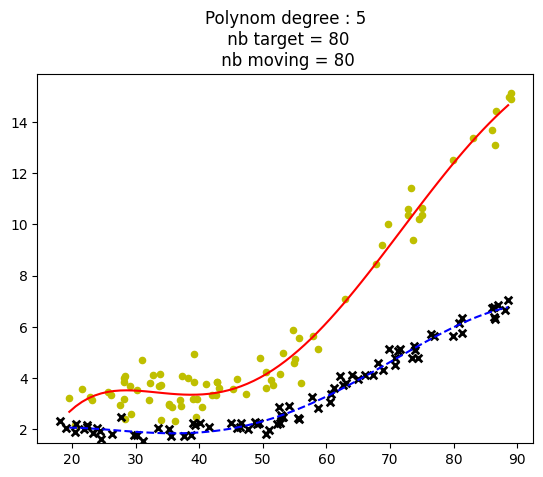

In [90]:
# Fit and plot the data
M = 5   # degree of the polynomial
lamb = 1  # regularization term

w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit(age_tar, y_tar, age_mov, y_mov, M = M, lamb = lamb)

plot_distribution(age_tar, y_tar, age_mov, y_mov, w_tar=w_tar, w_mov=w_mov)

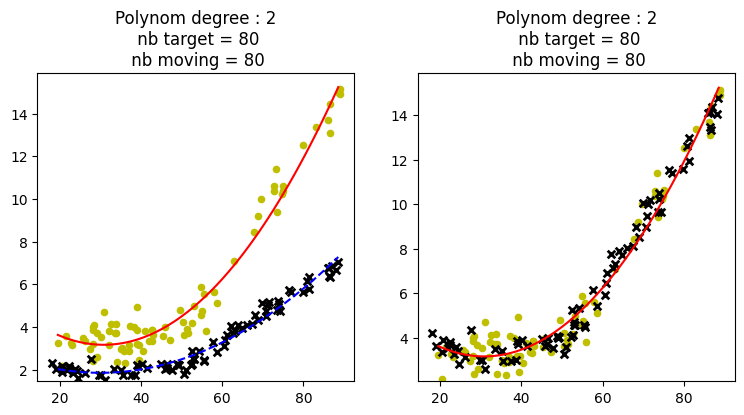

0.012369303385076786


In [91]:
# Fit, harmonize the moving site and plot the result
M = 2
lamb = 0
w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit(age_tar, y_tar, age_mov, y_mov, M = M, lamb = lamb)

y_mov_harm = clinical_combat_apply(w_tar, delta_tar, age_mov, y_mov, w_mov, delta_mov)
plot_before_after_harm_distribution(age_tar, y_tar, age_mov, y_mov, y_mov_harm, w_tar=w_tar, w_mov=w_mov)

qc_score = clinical_combat_qc(w_tar, age_tar, y_tar, age_mov, y_mov_harm)
print(qc_score)

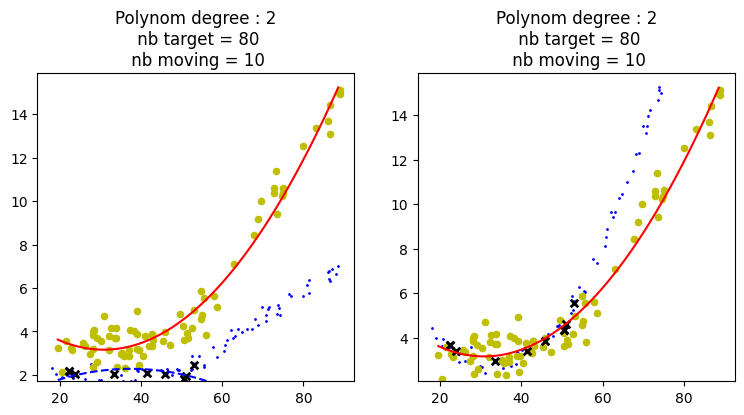

0.19049670881311292


In [92]:
# Get a subset of the moving site, 
# Combatfit, 
# harmonize the subset and the entire moving site
# plot the result

M = 2
lamb = 10

rnd_seed = -1
age_mov_subset, y_mov_subset = data_select(age_mov, y_mov, method = 'random', nb_elements=10, idx_min=1, idx_max=np.minimum(np.size(y_mov),40), rnd_seed = rnd_seed)

w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit(age_tar, y_tar, age_mov_subset, y_mov_subset, M = M, lamb = lamb)

t_harmonized = clinical_combat_apply(w_tar, delta_tar, age_mov_subset, y_mov_subset, w_mov, delta_mov)
t_harmonized_full = clinical_combat_apply(w_tar, delta_tar, age_mov, y_mov, w_mov, delta_mov)

plot_before_after_harm_distribution(age_tar, y_tar, age_mov_subset, y_mov_subset, t_harmonized, age_mov, y_mov, t_harmonized_full, w_tar, w_mov) 

qc_score = clinical_combat_qc(w_tar, age_tar, y_tar, age_mov_subset, t_harmonized)
print(qc_score)

# Clinical Combat 2.0

* Régression de degré M indépendante sur chaque site
* Régularization L2 entre le site moving et les paramètres du site target

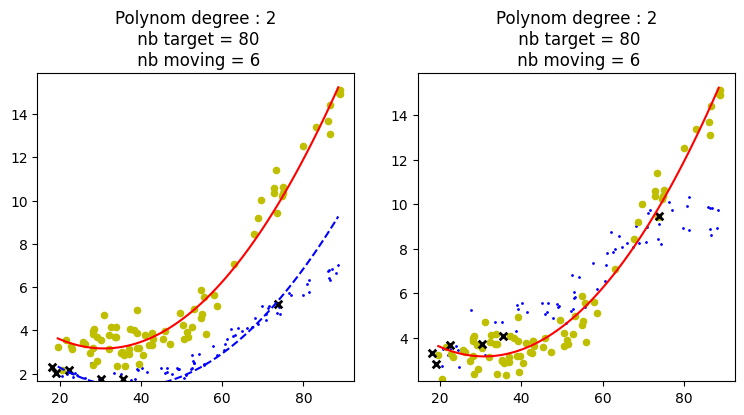

Qc_score =  0.2323504067984719


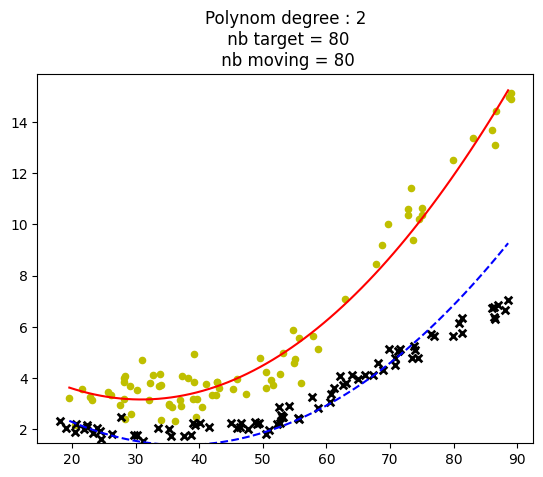

In [93]:
# Retreive 3 subset of subjets from the moving site : young, mid-age, old
# Combat fit and harmonize the subset and the entire moving site
# Compute the uncertainty table

M = 2
lamb = 250*M
sub_sample_dataset = True

idx_min = 0
idx_max = np.size(y_mov)
rnd_seed = -1

# select young and old subjects
nb_young = 5
nb_mid = 0
nb_old = 1
lamb /= np.power(1.1, nb_young+nb_mid+nb_old) #lambda decreases as the number of subjects increases

if sub_sample_dataset:
    age_mov_subset, y_mov_subset = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_young, idx_min=idx_min, idx_max=idx_max/3, rnd_seed = rnd_seed)
    age_mov_subset2, y_mov_subset2 = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_mid, idx_min=idx_max/3+1, idx_max=idx_max*0.66, rnd_seed = rnd_seed)
    age_mov_subset3, y_mov_subset3 = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_old, idx_min=idx_max*0.66+1, idx_max=idx_max, rnd_seed = rnd_seed)

    age_mov_subset = np.append(age_mov_subset, np.append(age_mov_subset2, age_mov_subset3))
    y_mov_subset = np.append(y_mov_subset, np.append(y_mov_subset2, y_mov_subset3))
else:
    age_mov_subset = age_mov
    y_mov_subset = y_mov

# Fit
w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit_v2(age_tar, y_tar, age_mov_subset, y_mov_subset, M = M, lamb_tar = 0, lamb_mov = lamb)

# Harmonize
y_mov_subset_harm = clinical_combat_apply(w_tar, delta_tar, age_mov_subset, y_mov_subset, w_mov, delta_mov)
y_mov_harm = clinical_combat_apply(w_tar, delta_tar, age_mov, y_mov, w_mov, delta_mov)

# Plot
plot_before_after_harm_distribution(age_tar, y_tar, \
                                    age_mov_subset, y_mov_subset, y_mov_subset_harm, \
                                    age_mov, y_mov, y_mov_harm, \
                                    w_tar, w_mov) 

qc_score = clinical_combat_qc(w_tar, age_tar, y_tar, age_mov, y_mov_harm)


print("Qc_score = ", qc_score)

plot_distribution(age_tar, y_tar, age_mov, y_mov, w_tar=w_tar, w_mov=w_mov)

64.28053235558063


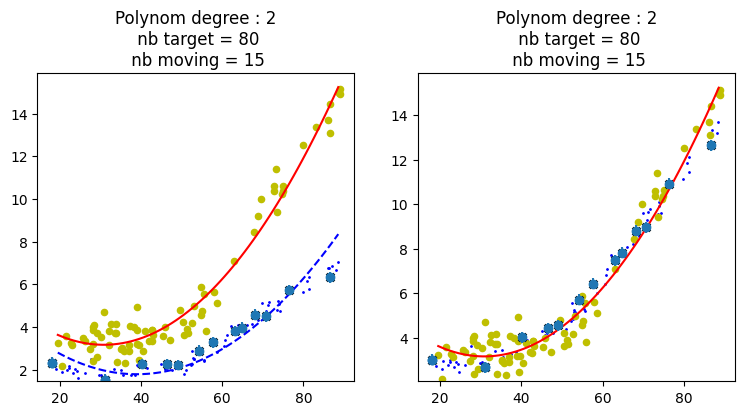

Uncertainty =  0.2480618500213463


In [94]:
# Same thing than in the previous cell
# + Compute the uncertainty table
M = 2
lamb = 5000*M

idx_min = 0
idx_max = np.size(y_mov)
rnd_seed = -1

# select young and old subjects
nb_young = 5
nb_mid = 5
nb_old = 5
lamb /= np.power(1.4, nb_young+nb_mid+nb_old) #lambda decreases as the number of subjects increases
print(lamb)

age_mov_subset, y_mov_subset = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_young, idx_min=idx_min, idx_max=idx_max/3, rnd_seed = rnd_seed)
age_mov_subset2, y_mov_subset2 = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_mid, idx_min=idx_max/3+1, idx_max=idx_max*0.66, rnd_seed = rnd_seed)
age_mov_subset3, y_mov_subset3 = data_select(age_mov, y_mov, method = 'random', nb_elements=nb_old, idx_min=idx_max*0.66+1, idx_max=idx_max, rnd_seed = rnd_seed)

age_mov_subset = np.append(age_mov_subset, np.append(age_mov_subset2, age_mov_subset3))
y_mov_subset = np.append(y_mov_subset, np.append(y_mov_subset2, y_mov_subset3))

# Fit
w_tar, w_mov, delta_tar, delta_mov = clinical_combat_fit_v2(age_tar, y_tar, age_mov_subset, y_mov_subset, M = M, lamb_tar = 0, lamb_mov = lamb)

# Harmonize
age_mov_subset_harm = clinical_combat_apply(w_tar, delta_tar, age_mov_subset, y_mov_subset, w_mov, delta_mov)
y_mov_harm = clinical_combat_apply(w_tar, delta_tar, age_mov, y_mov, w_mov, delta_mov)

# Compute uncertainty table
uncertainty_table = site_wise_uncertainty_estimation(age_tar, y_tar, age_mov, y_mov, M = M)

# Plot
plot_before_after_harm_distribution(age_tar, y_tar, \
                                    age_mov_subset, y_mov_subset, age_mov_subset_harm, \
                                    age_mov, y_mov, y_mov_harm, \
                                    w_tar, w_mov, uncertainty_table[nb_young + nb_mid + nb_old]) 

print("Uncertainty = ", uncertainty_table[nb_young + nb_mid + nb_old])

# Analyze STD error 

1
2
4
8
16
32


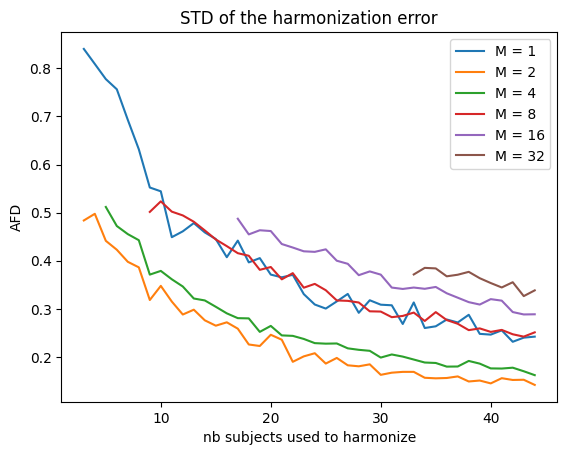

In [95]:
# Compute the uncertainty measure for a wide range of M values
unc_tab = []

nb_subject_max = np.minimum(70, np.size(y_mov)-1)
nb_subjets = np.arange(0,nb_subject_max)

M = 1
for m in range(1, 12, 2):
    print(M)
    unc_tab = site_wise_uncertainty_estimation(age_tar, y_tar, age_mov, y_mov, M = M)

    idx_min = np.maximum(3, M+1)
    plt.plot(nb_subjets[idx_min:np.size(unc_tab)], unc_tab[idx_min:], label='M = ' + str(M))
    M *= 2

plt.legend()
plt.title("STD of the harmonization error")
plt.ylabel('AFD')
plt.xlabel('nb subjects used to harmonize')
plt.show()

# Analyse QC Score


1
2
4


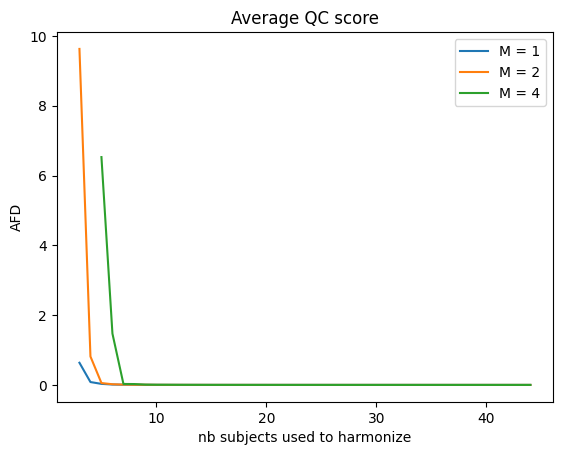

In [96]:
# Compute the qc score for a wide range of M values
qc_tab = []

nb_subject_max = np.minimum(70, np.size(y_mov)-1)
nb_subjets = np.arange(0,nb_subject_max)

M = 1
for m in range(1, 6, 2):
    print(M)
    qc_tab = site_wise_qc_score_estimation(age_tar, y_tar, age_mov, y_mov, M = M)

    idx_min = np.maximum(3, M+1)
    plt.plot(nb_subjets[idx_min:np.size(qc_tab)], qc_tab[idx_min:], label='M = ' + str(M))
    M *= 2

plt.legend()
plt.title("Average QC score")
plt.ylabel('AFD')
plt.xlabel('nb subjects used to harmonize')
plt.show()

/tmp/ipykernel_370901/1368266741.py:2: DtypeWarning: Columns (6) have mixed types. Specify dtype option on import or set low_memory=False.
  dataset = pd.read_csv('./data/MP2_dti_md_ransac.data.cov.csv')


['left_ventricle' 'mni_AC' 'mni_AF_L' 'mni_AF_R' 'mni_AST_L' 'mni_AST_R'
 'mni_CC' 'mni_CCMid' 'mni_CC_ForcepsMajor' 'mni_CC_ForcepsMinor'
 'mni_CST_L' 'mni_CST_R' 'mni_C_L' 'mni_C_R' 'mni_FPT_L' 'mni_FPT_R'
 'mni_F_L_R' 'mni_ICP_L' 'mni_ICP_R' 'mni_IFOF_L' 'mni_IFOF_R'
 'mni_IIT_mask_skeletonFA' 'mni_ILF_L' 'mni_ILF_R' 'mni_MCP' 'mni_ML_L'
 'mni_ML_R' 'mni_MdLF_L' 'mni_MdLF_R' 'mni_OPT_L' 'mni_OPT_R' 'mni_OR_L'
 'mni_OR_R' 'mni_PPT_L' 'mni_PPT_R' 'mni_SCP' 'mni_SLF_L' 'mni_SLF_R'
 'mni_STT_L' 'mni_STT_R' 'mni_UF_L' 'mni_UF_R' 'mni_VOF_L' 'mni_VOF_R'
 'right_ventricle']
adni_127_GE_3T  Nb Subjets =  54
1
VARIANCE : delta_mov vs delta_tar 2.294742405774455e-05 3.1151675204008936e-05
VAR_fit :  2.302269241688459e-05
VARIANCE : delta_mov vs delta_tar 1.5584242917137575e-05 3.1151675204008936e-05
VAR_fit :  1.7808161815262056e-05
 APPLY : delta_mov va delta_tar 1.7808161815262056e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -3.2526065174565133e-19
sigma_tar v

/tmp/ipykernel_370901/2680505988.py:143: RuntimeWarning: divide by zero encountered in double_scalars
  dist = np.log( (sigma_tar + sigma_harm)/(2*np.sqrt(sigma_tar)*np.sqrt(sigma_harm)) ) / 2  +  (mean_tar-mean_harm)**2 / (sigma_tar+sigma_harm) / 4


mean_tar vs mean_harm =  -1.9961479250434055e-19 -1.7037462710486498e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.806734233195207e-05
VARIANCE : delta_mov vs delta_tar 1.90025900811859e-05 3.1151675204008936e-05
VAR_fit :  1.9812529089374102e-05
 APPLY : delta_mov va delta_tar 1.9812529089374102e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -3.097720492815727e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.9878190289270402e-05
VARIANCE : delta_mov vs delta_tar 1.3991117258622376e-05 3.1151675204008936e-05
VAR_fit :  1.513515445498148e-05
 APPLY : delta_mov va delta_tar 1.513515445498148e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 4.4916947145828045e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.879698002938824e-05
VARIANCE : delta_mov vs delta_tar 1.2269253966893216e-05 3.1151675204008936e-05
VAR_fit :  1.3528082049367598e-05
 APPLY : delta_mov va delta_tar 1.3528082049367598e-05 3.115167520400893

/tmp/ipykernel_370901/2680505988.py:143: RuntimeWarning: divide by zero encountered in double_scalars
  dist = np.log( (sigma_tar + sigma_harm)/(2*np.sqrt(sigma_tar)*np.sqrt(sigma_harm)) ) / 2  +  (mean_tar-mean_harm)**2 / (sigma_tar+sigma_harm) / 4


VARIANCE : delta_mov vs delta_tar 1.68976364513752e-05 3.1151675204008936e-05
VAR_fit :  1.7736109319177182e-05
 APPLY : delta_mov va delta_tar 1.7736109319177182e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -1.0842021724855044e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.9678982745077186e-05
VARIANCE : delta_mov vs delta_tar 2.5293597195819292e-05 3.1151675204008936e-05
VAR_fit :  2.5638190019830448e-05
 APPLY : delta_mov va delta_tar 2.5638190019830448e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -9.486769009248164e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 3.073297779506843e-05
VARIANCE : delta_mov vs delta_tar 2.5631588768486627e-05 3.1151675204008936e-05
VAR_fit :  2.5956299735282056e-05
 APPLY : delta_mov va delta_tar 2.5956299735282056e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -1.3552527156068805e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 3.07619705590

/tmp/ipykernel_370901/2680505988.py:143: RuntimeWarning: divide by zero encountered in double_scalars
  dist = np.log( (sigma_tar + sigma_harm)/(2*np.sqrt(sigma_tar)*np.sqrt(sigma_harm)) ) / 2  +  (mean_tar-mean_harm)**2 / (sigma_tar+sigma_harm) / 4


VARIANCE : delta_mov vs delta_tar 6.160227369144915e-06 3.1151675204008936e-05
VAR_fit :  8.432177172314371e-06
 APPLY : delta_mov va delta_tar 8.432177172314371e-06 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 4.1199682554449167e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.2758226999371507e-05
VARIANCE : delta_mov vs delta_tar 1.2215047478966413e-05 3.1151675204008936e-05
VAR_fit :  1.3936559090333915e-05
 APPLY : delta_mov va delta_tar 1.3936559090333915e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 2.168404344971009e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.730366866023834e-05
VARIANCE : delta_mov vs delta_tar 1.1540420791566594e-05 3.1151675204008936e-05
VAR_fit :  1.3323262101788625e-05
 APPLY : delta_mov va delta_tar 1.3323262101788625e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 1.517883041479706e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.6983139524682263

/tmp/ipykernel_370901/4064125548.py:19: RuntimeWarning: overflow encountered in power
  lamb /= np.power(1.5, np.size(y_mov))


VARIANCE : delta_mov vs delta_tar 2.8082010515319253e-05 3.1151675204008936e-05
VAR_fit :  2.8286654827898563e-05
 APPLY : delta_mov va delta_tar 2.8286654827898563e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 2.168404344971009e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 3.0926303444901864e-05
VARIANCE : delta_mov vs delta_tar 1.7509180727427274e-05 3.1151675204008936e-05
VAR_fit :  1.8418680359199384e-05
 APPLY : delta_mov va delta_tar 1.8418680359199384e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -2.323290369611795e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.961343052118727e-05
VARIANCE : delta_mov vs delta_tar 1.697935455378392e-05 3.1151675204008936e-05
VAR_fit :  1.7924175930465586e-05
 APPLY : delta_mov va delta_tar 1.7924175930465586e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -3.097720492815727e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.9509604250991

/tmp/ipykernel_370901/2680505988.py:143: RuntimeWarning: divide by zero encountered in double_scalars
  dist = np.log( (sigma_tar + sigma_harm)/(2*np.sqrt(sigma_tar)*np.sqrt(sigma_harm)) ) / 2  +  (mean_tar-mean_harm)**2 / (sigma_tar+sigma_harm) / 4


VARIANCE : delta_mov vs delta_tar 1.2851204401445425e-05 3.1151675204008936e-05
VAR_fit :  1.392770268394916e-05
 APPLY : delta_mov va delta_tar 1.392770268394916e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 0.0
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.8743903756326014e-05
VARIANCE : delta_mov vs delta_tar 1.3954292505680197e-05 3.1151675204008936e-05
VAR_fit :  1.496590325264071e-05
 APPLY : delta_mov va delta_tar 1.496590325264071e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -3.1170812458958252e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.9045997458388188e-05
VARIANCE : delta_mov vs delta_tar 1.0237135441540296e-05 3.1151675204008936e-05
VAR_fit :  1.1467402486391392e-05
 APPLY : delta_mov va delta_tar 1.1467402486391392e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -8.131516293641283e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.7809603672040108e-05
VARIANCE : 

/tmp/ipykernel_370901/4064125548.py:19: RuntimeWarning: overflow encountered in power
  lamb /= np.power(1.5, np.size(y_mov))


VARIANCE : delta_mov vs delta_tar 1.503058499601819e-05 3.1151675204008936e-05
VAR_fit :  1.6821817241350494e-05
 APPLY : delta_mov va delta_tar 1.6821817241350494e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -8.131516293641283e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.783456122512351e-05
VARIANCE : delta_mov vs delta_tar 1.8901964118234566e-05 3.1151675204008936e-05
VAR_fit :  2.026304312776505e-05
 APPLY : delta_mov va delta_tar 2.026304312776505e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -8.131516293641283e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.905920118791259e-05
VARIANCE : delta_mov vs delta_tar 2.19192058230779e-05 3.1151675204008936e-05
VAR_fit :  2.294503575429246e-05
 APPLY : delta_mov va delta_tar 2.294503575429246e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 8.131516293641283e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.975894166574155e-05


/tmp/ipykernel_370901/4064125548.py:19: RuntimeWarning: overflow encountered in power
  lamb /= np.power(1.5, np.size(y_mov))


VARIANCE : delta_mov vs delta_tar 2.782285491775917e-05 3.1151675204008936e-05
VAR_fit :  2.819272383845359e-05
 APPLY : delta_mov va delta_tar 2.819272383845359e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 -1.8973538018496328e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 3.074298690019156e-05
VARIANCE : delta_mov vs delta_tar 2.645546695316023e-05 3.1151675204008936e-05
VAR_fit :  2.6977267869921197e-05
 APPLY : delta_mov va delta_tar 2.6977267869921197e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 2.710505431213761e-20
sigma_tar vs sigma_harm =  3.1151675204008936e-05 3.05491318790707e-05
VARIANCE : delta_mov vs delta_tar 1.0873038725167606e-05 3.1151675204008936e-05
VAR_fit :  1.3126220556149976e-05
 APPLY : delta_mov va delta_tar 1.3126220556149976e-05 3.1151675204008936e-05
mean_tar vs mean_harm =  -1.9961479250434055e-19 1.0842021724855044e-19
sigma_tar vs sigma_harm =  3.1151675204008936e-05 2.5804333349277488e

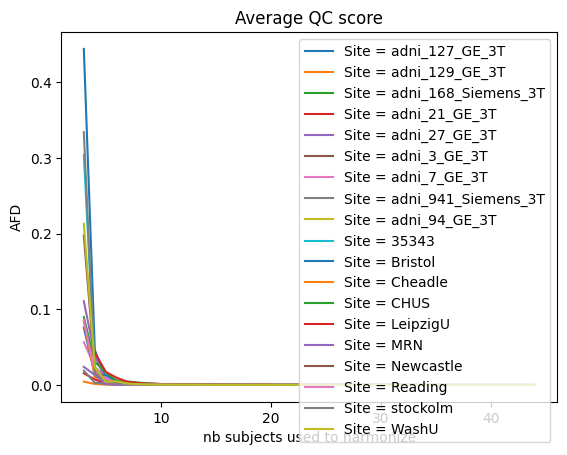

In [493]:
bundle = 'mni_CST_R'
dataset = pd.read_csv('./data/MP2_dti_md_ransac.data.cov.csv')
site_names = dataset[['site']].stack().unique()
bundles = dataset[['bundle']].stack().unique()
print(bundles)

age_tar, y_tar, sid_tar = load_multi_site_csv('./data/MP2_dti_md_ransac.data.cov.csv', bundle_name = bundle, site = 'MRC-CBSU_Siemens_3T_2', sex = 'M', disease = 'HC', ds = dataset)

for site in site_names:

    if site == 'MRC-CBSU_Siemens_3T_2':
        continue

    age_mov, y_mov, sid_mov = load_multi_site_csv('./data/MP2_dti_md_ransac.data.cov.csv', bundle_name = bundle, site = site, sex = 'F', disease = 'HC', ds = dataset)
    
    if np.size(y_mov) < 15:
        continue
    print(site, " Nb Subjets = ", np.size(y_mov))

    nb_subject_max = np.minimum(70, np.size(y_mov)-1)
    nb_subjets = np.arange(0,nb_subject_max)
    
    M = 1
    for m in range(1, 2, 2):
        print(M)
        qc_tab = site_wise_qc_score_estimation(age_tar, y_tar, age_mov, y_mov, M = M)
    
        idx_min = np.maximum(3, M+1)
        plt.plot(nb_subjets[idx_min:np.size(qc_tab)], qc_tab[idx_min:], label='Site = ' + site)
        M *= 2
    
    plt.legend()
    plt.title("Average QC score")
    plt.ylabel('AFD')
    plt.xlabel('nb subjects used to harmonize')
plt.show()
